---
Title : Application_VGGish  
Author : Dmitrašinović Théotime  
Date : 25/10/2023  
**But** :  
1. Application du modèle pré entrainné VGGish pour récupérer les embeddings de chaque fenetre de temps pour chaque fichier audio.  
2. Appliquer les différentes méthodes de post-process
  
---

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
MetaDataPath = "/content/gdrive/MyDrive/Projet_Multimedia/download/endroit/"
VideoPath = "/content/gdrive/MyDrive/Projet_Multimedia/videos/"
AudioPath = "/content/gdrive/MyDrive/Projet_Multimedia/download/Audio/"

In [ ]:
from os import listdir
from os.path import isfile, join
AudioFiles = [f for f in listdir(AudioPath) if isfile(join(AudioPath, f))]
len(AudioFiles)

2280

# VGGish PreTrained Model

- VGGish is a pre-trained deep learning model for audio classification developed by Google.  
- It's trained on a large dataset and can classify audio into 128 categories.  
- You can find the pre-trained model and usage examples in the [VGGish repository](https://github.com/tensorflow/models/tree/master/research/audioset/vggish).  


## Petit exemple sur 1 fichier audio

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
import numpy as np

# Load the model.
model = hub.load('https://www.kaggle.com/models/google/vggish/frameworks/TensorFlow2/variations/vggish/versions/1')
#model = hub.load('https://tfhub.dev/google/vggish/1')

In [ ]:
import librosa
filename = AudioPath+AudioFiles[0]
print(filename)
waveform , sr = librosa.load(filename , sr=16000)
# Run the model, check the output.
embeddings = model(waveform)
embeddings.shape.assert_is_compatible_with([None, 128])

/content/gdrive/MyDrive/Projet_Multimedia/download/Audio/-AZS5cgybKcI.mp3


In [ ]:
from IPython.display import Audio
# lecture du fichier
Audio(data=waveform, rate=sr)

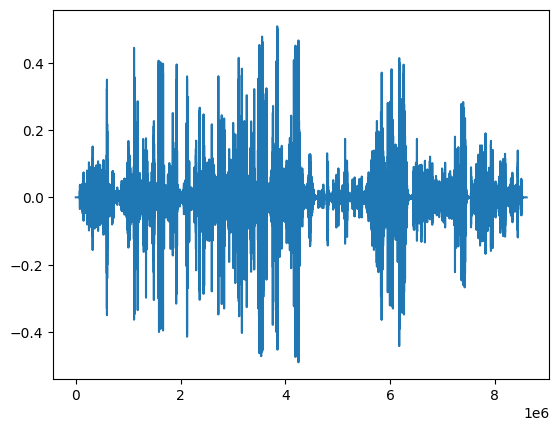

In [ ]:
import matplotlib.pyplot as plt
plt.plot(waveform)

In [ ]:
embeddings[0]

<tf.Tensor: shape=(128,), dtype=float32, numpy=
array([-0.2699438 , -0.05464327, -0.13708228,  0.2957466 , -0.0502203 ,
       -0.07128555, -0.04282161, -0.1050786 , -0.1758085 , -0.05651304,
       -0.16055715, -0.23815753,  0.5866772 ,  0.15900977, -0.0940691 ,
       -0.03868847,  0.23309661,  0.3222829 ,  0.2295783 , -0.3562043 ,
       -0.065191  , -0.1701361 , -0.04245314, -0.137271  ,  0.22625428,
       -0.02531567, -0.11857533,  0.25978324,  0.43351257, -0.01616946,
       -0.03886629, -0.13310376,  0.14564757,  0.07832267,  0.24413311,
       -0.26247442, -0.20033681, -0.0599587 , -0.0748346 , -0.12700903,
        0.37677678, -0.01663098,  0.05165651, -0.07253101,  0.5926883 ,
       -0.1363227 ,  0.4093753 ,  0.39000928,  0.4690643 ,  0.27611083,
       -0.14518489, -0.18488438, -0.2550227 , -0.08968319,  0.15076083,
        0.06404199, -0.07894009, -0.1167974 ,  0.07755925, -0.02841283,
        0.152667  ,  0.38160336, -0.1236892 , -0.16008423, -0.04037602,
       -0.076023

# Protocole
1. **Data Preparation**:  
Organize your dataset, which should include labeled audio clips and their corresponding VGGish embeddings.
Split your dataset into training, validation, and test sets.  
  

2. **Classifier Selection**:  
Choose a classifier suitable for audio classification. Common choices include deep neural networks (e.g., convolutional neural networks, recurrent neural networks), support vector machines, or random forests.
Depending on the size of your dataset, consider using transfer learning with pre-trained models.  
  

3. **Model Architecture**:  
Define the architecture of your classifier. If using deep learning, define the layers, activation functions, and loss function.
You may choose to combine the VGGish embeddings with other audio features or use the embeddings alone as input to the classifier.  
  

4. **Training**:  
Train your classifier using the training dataset. Input the VGGish embeddings and the corresponding labels.
Monitor the training process and adjust hyperparameters as needed.  
  

5. **Validation**:  
Use the validation dataset to evaluate the classifier's performance. This helps you identify overfitting and fine-tune the model.  
  

6. **Testing**:  
Finally, evaluate the classifier on the test dataset to get an accurate measure of its performance.  
  

7. **Hyperparameter Tuning**:  
Experiment with different hyperparameters (e.g., learning rate, batch size) and architectural choices to optimize classifier performance.  
  

8. **Inference**:  
Once your classifier is trained and validated, you can use it for inference on new, unlabeled audio clips.
Pass the VGGish embeddings of an audio clip through the trained classifier to predict its category.  

# Data Preparation

In [ ]:
AudioFiles = [f for f in listdir(AudioPath) if isfile(join(AudioPath, f))]
len(AudioFiles)

2280

In [ ]:
MetaFiles = [f for f in listdir(MetaDataPath) if isfile(join(MetaDataPath, f))]
print(MetaFiles)

['assets-oAeBwuWRtdM.json', 'assets-dc6RIHl24SI.json', 'assets-7aXpBF2mjtg.json', 'assets-7lwY5KL19Zg.json', 'assets-82nmyWfWBYg.json', 'assets-dx0-pNkwOv8.json', 'assets-SCxpWYgfLEk.json', 'assets-baNaqhoBjUE.json', 'assets-F7Ug863S8dQ.json', 'assets-kxzG4szI61U.json', 'assets-IrJ4rmE2zuY.json', 'assets-ndh11VDx_J8.json', 'assets-Fnd-2jetT1w.json', 'assets-G8KpPw303PY.json', 'assets-Cdpf1Dl5b_4.json', 'assets-RaRpFuSLyPI.json', 'assets-S1Cn8vIGlLo.json', 'assets-UpH334PWtrM.json', 'assets-dZiJkicepzM.json', 'assets-ajzArdLK6tE.json', 'assets-o-50GjySwew.json', 'assets-NdPPIkVTpB4.json', 'assets-f5FRPrbngPY.json', 'assets-j3cEnP8VCvg.json', 'assets-tOAkMKhVbDQ.json', 'assets-qXaVW254f6c.json', 'assets-DSBhSywLRNA.json', 'assets-RVMAwGXe3BY.json', 'assets--bCmuE3KxWI.json', 'assets-9fjEsxhmQi0.json', 'assets-_6PNGyfwjTA.json', 'assets-DH2DgD9Rdi0.json', 'assets-i1GyF14WKjQ.json', 'assets-560EpNc2rKg.json', 'assets-d5TiaQeuNO0.json', 'assets-GPQwSEzXBXU.json', 'assets-BxyXk1sr2io.json', 

In [ ]:

AudioFiles[0][:-4]


'-AZS5cgybKcI.'

In [ ]:
test = {"iuefjeif":{"embe":[2591,9961616,2621622,6262626,62,62,62,622626,62,62,62,78], "label":"cooking"}, "iojlijl":{"embe":[2591,9961616,28484,84,84,48,58,22626,62,62,62,78], "label":"gaming"}}

In [ ]:
test = {"iuefjeif":[2591,9961616,2621622,699962626,62,62,62,622626,62,62,62,78], "kok":[259889898,9961616,2621622,6262626,62,62,62,622626,62,62,62,78]}

In [ ]:
pd.DataFrame.from_dict(test, orient='index')

,0,1,2,3,4,5,6,7,8,9,10,11
iuefjeif,2591,9961616,2621622,6262626,62,62,62,622626,62,62,62,78


## Create Embeddings

In [ ]:
!pip install pydub

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
import numpy as np
import os
import pandas as pd
import librosa
import pydub

In [ ]:
# Load the model.
model = hub.load('https://www.kaggle.com/models/google/vggish/frameworks/TensorFlow2/variations/vggish/versions/1')
#model = hub.load('https://tfhub.dev/google/vggish/1')

In [ ]:
AudioEmbeddingsPath = "/content/gdrive/MyDrive/Projet_Multimedia/download/Audio_Embeddings/"

In [ ]:
import pickle
def save_embeddings(all_embe, folder_path, version):
  # save all embeddings
  with open(folder_path + 'all_embeddings_'+version+'.pkl', 'wb') as ff:
    pickle.dump(all_embe, ff)
  # save list of id
  with open(folder_path + "log_"+version+".pkl", "wb") as fp:
    pickle.dump(list(all_embe.keys()), fp)


In [ ]:
import json
import codecs
def save_embeddings_json(all_embe, folder_path, version):
  # save all embeddings
  json_object = json.dumps(all_embe)
  with codecs.open(folder_path + 'all_embeddings_'+version+'.json', 'w', encoding='utf-16') as writefile:
    writefile.write(json_object)
  #with open(folder_path + 'all_embeddings_'+version+'.json', 'w') as ff:
  #  json.dump(all_embe, ff)
  # save list of id
  with open(folder_path + "log_"+version+".pkl", "wb") as fp:
    pickle.dump(list(all_embe.keys()), fp)

In [ ]:
from tqdm.notebook import tqdm_notebook
import time
def all_embe(listAudioFiles, fctPostProcess, AudioEmbeddingsPath, version, logs=[]):
  """
  Permet d'utiliser plusieurs fonctions de Post Process Embedding
  """
  all_embe={}
  for audioFile in tqdm_notebook(listAudioFiles, desc="Fichiers Audios Traités"):
    if audioFile[:-4] not in logs:

      print(audioFile)
      # get audio signal
      audioPath = AudioPath + audioFile
      try:
        waveform , sr = librosa.load(audioPath , sr=16000)
      except:
        print("librosa.load")
      try:
        # Run the model, check the output.
        embeddings = model(waveform)
      except:
        print("moedl")
      try:
        all_embe[audioFile[:-4]] = fctPostProcess(embeddings)
      except:
        print("fctPostProcess")
      try:
      # save on disk
        save_embeddings(all_embe, AudioEmbeddingsPath, version)
      except:
        print("pb de sauvegarde")
    else:
      time.sleep(0.01)

  return all_embe

In [ ]:
from tqdm.notebook import tqdm_notebook
import time
def all_embe(listAudioFiles, fctPostProcess, AudioEmbeddingsPath, version, logs=[]):
  """
  Permet d'utiliser plusieurs fonctions de Post Process Embedding
  """
  all_embe={}
  for audioFile in tqdm_notebook(listAudioFiles, desc="Fichiers Audios Traités"):
    # si pas encore traité
    if audioFile[:-4] not in logs:
      # si fichier trop volumineux
      if os.path.getsize(AudioPath+audioFile) > 30000000:
        OutPath = scinderAudio(AudioPath, audioFile)
        files = [f for f in listdir(OutPath) if isfile(join(OutPath, f))]
        embes = []
        for afile in files:
          # get audio signal
          audioPath = OutPath + afile
          waveform , sr = librosa.load(audioPath , sr=16000)
          # Run the model, check the output.
          embes.append(fctPostProcess(model(waveform)))
        for afile in files:
          os.remove(OutPath+afile)
        all_embe[audioFile[:-4]] = fctPostProcess(embes)
      else:
        # get audio signal
        audioPath = AudioPath + audioFile
        waveform , sr = librosa.load(audioPath , sr=16000)
        # Run the model, check the output.
        embeddings = model(waveform)
        all_embe[audioFile[:-4]] = fctPostProcess(embeddings)

      # save on disk
      save_embeddings(all_embe, AudioEmbeddingsPath, version)
    else:
      time.sleep(0.005)

  return all_embe

In [ ]:
from tqdm.notebook import tqdm_notebook
import time
def all_all_embe(listAudioFiles, AudioEmbeddingsPath, version, logs=[]):
  """
  Permet d'utiliser plusieurs fonctions de Post Process Embedding
  """
  all_embe={}
  for audioFile in tqdm_notebook(listAudioFiles, desc="Fichiers Audios Traités"):
    # si pas encore traité
    if audioFile[:-4] not in logs:
      # si fichier trop volumineux
      if os.path.getsize(AudioPath+audioFile) > 30000000:
        OutPath = scinderAudio(AudioPath, audioFile)
        files = [f for f in listdir(OutPath) if isfile(join(OutPath, f))]
        # init de la liste de vecteurs qui va recevoir la concaténation des sous parties audio d'un fichier audio
        embes = np.array([[0 for i in range(128)]])
        for afile in files:
          # get audio signal
          audioPath = OutPath + afile
          waveform , sr = librosa.load(audioPath , sr=16000)
          # Run the model, check the output.
          embes = np.concatenate((embes, model(waveform).numpy()), axis=0)
          os.remove(OutPath+afile)
        all_embe[audioFile[:-4]] = embes.tolist()[1:]
      else:
        # get audio signal
        audioPath = AudioPath + audioFile
        waveform , sr = librosa.load(audioPath , sr=16000)
        # Run the model, check the output.
        embeddings = model(waveform)
        all_embe[audioFile[:-4]] = embeddings.numpy().tolist()

      # save on disk
      save_embeddings(all_embe, AudioEmbeddingsPath, version)
    else:
      time.sleep(0.005)

  return all_embe

In [ ]:
from pydub import AudioSegment
def scinderAudio(AudioPath, fileName, maxi = 4000000):
  OutPath = "/content/gdrive/MyDrive/Projet_Multimedia/download/Audio_Temp/"
  sound = AudioSegment.from_mp3(AudioPath+fileName)
  bordures = [i*maxi for i in range(int(np.ceil(len(sound) / maxi)))] + [len(sound)]
  for s in range(len(bordures)-1):
    sound[bordures[s]:bordures[s+1]].export(OutPath+fileName[:-4]+str(bordures[s+1])+".mp3", format="mp3")
  print(fileName, " Scindé en", len(bordures)-1, "parties")
  return OutPath

In [ ]:
with open(AudioEmbeddingsPath + 'log_Averaging_up_to_1188.pkl', "rb") as fp:
    logs2 = pickle.load(fp)
with open(AudioEmbeddingsPath + 'log_Averaging_up_to_556.pkl', "rb") as fp:
    logs1 = pickle.load(fp)
with open(AudioEmbeddingsPath + 'log_Averaging_up_to_end.pkl', "rb") as fp:
    logs3 = pickle.load(fp)
logs = logs1 + logs2 + logs3
len(logs)
#with open(AudioEmbeddingsPath + 'all_embeddings_Averaging.pkl', "rb") as fp:
#    embes = pickle.load(fp)

NameError: ignored

In [ ]:
AudioEmbeddingsPath = "/content/gdrive/MyDrive/Projet_Multimedia/download/Audio_Embeddings/"
with open(AudioEmbeddingsPath + 'log_Averaging.pkl', "rb") as fp:
    logs1 = pickle.load(fp)

In [ ]:
AudioFiles[556]

'-3BQm_EQhggU.mp3'

In [ ]:
AudioEmbeddingsPath = "/content/gdrive/MyDrive/Projet_Multimedia/download/Audio_Embeddings/"
AudioPath = "/content/gdrive/MyDrive/Projet_Multimedia/download/Audio/"
AudioFiles = [f for f in listdir(AudioPath) if isfile(join(AudioPath, f))]

ALL = all_embe(AudioFiles, max_pooling, AudioEmbeddingsPath, "max_pooling", logs1=[])

TypeError: ignored

#### ALL

In [ ]:
AudioEmbeddingsPath = "/content/gdrive/MyDrive/Projet_Multimedia/download/Audio_Embeddings/VGGish/"
AudioPath = "/content/gdrive/MyDrive/Projet_Multimedia/download/Audio/"
AudioFiles = [f for f in listdir(AudioPath) if isfile(join(AudioPath, f))]

In [ ]:
with open(AudioEmbeddingsPath + 'log_ALL_ALL_up_to_318.pkl', "rb") as fp:
    logs1 = pickle.load(fp)
with open(AudioEmbeddingsPath + 'log_ALL_ALL_up_to_894.pkl', "rb") as fp:
    logs2 = pickle.load(fp)
with open(AudioEmbeddingsPath + 'log_ALL_ALL_up_to_1645.pkl', "rb") as fp:
    logs3 = pickle.load(fp)
with open(AudioEmbeddingsPath + 'log_ALL_ALL_up_to_end.pkl', "rb") as fp:
    logs4 = pickle.load(fp)
with open(AudioEmbeddingsPath + 'log_pas_fait.pkl', "rb") as fp:
    logs5 = pickle.load(fp)
print(set(logs1).intersection(set(logs2)))
print(set(logs1+logs2).intersection(set(logs3)))
print(set(logs1+logs2+logs3).intersection(set(logs4)))
print(set(logs1+logs2+logs3+logs4).intersection(set(logs5)))
print(set(logs3).intersection(logs5))
logs = logs1 + logs2 + logs3 + logs4 + logs5
len(logs)

set()
set()
set()
{'-nGkUzdNi_gs', '-9pX1hxYW3YY', '-RFUE09SRO8w', '-hcfOhIWWgB0', '-DYldBHQw3s4', '-x-wcNG_Njk8', '--WwPXYlVwnk', '-fj3u4Wd2C-8', '-HX8KX5u0gkg', '-14GZruL1hrE', '-XxhKUP9Ixco', '-9qSEfcIfYbw', '-g2wsNw07wRY', '-E5SC6W0ggKU', '-PRi89x1cC-M', '-ixh8KqEr6LE', '-oPwrodxghrw', '-B8eBmqNyxBg', '-xoPJu25ZHxM', '-QFMMD4JwTwM', '-SHR0GuIf5eM', '-YnogUErj_g0', '-JM1pDskO-mM', '-LKFuXETZUsI', '-by1s5NZZcpc', '-5AMLqG8TswM', '--IRNEMiRg0Y'}
{'-9pX1hxYW3YY', '-RFUE09SRO8w', '-nGkUzdNi_gs', '-hcfOhIWWgB0', '-DYldBHQw3s4', '-x-wcNG_Njk8', '--WwPXYlVwnk', '-fj3u4Wd2C-8', '-HX8KX5u0gkg', '-14GZruL1hrE', '-XxhKUP9Ixco', '-9qSEfcIfYbw', '-g2wsNw07wRY', '-E5SC6W0ggKU', '-PRi89x1cC-M', '-ixh8KqEr6LE', '-oPwrodxghrw', '-B8eBmqNyxBg', '-xoPJu25ZHxM', '-QFMMD4JwTwM', '-SHR0GuIf5eM', '-YnogUErj_g0', '-JM1pDskO-mM', '-LKFuXETZUsI', '-by1s5NZZcpc', '-5AMLqG8TswM', '--IRNEMiRg0Y'}


2307

In [ ]:
# GOOD ALL ALL
# extraction de tous les embeddings de chaque fenetres temporelle
ALL = all_all_embe(AudioFiles, AudioEmbeddingsPath, "ALL_ALL", logs=logs)

Fichiers Audios Traités:   0%|          | 0/2280 [00:00<?, ?it/s]

-e_t6_zCrwz0.mp3  Scindé en 2 parties
-SiRQum0n2b0.mp3  Scindé en 1 parties
-JAAQ2FnnkX8.mp3  Scindé en 2 parties
-KsREXvSMe9c.mp3  Scindé en 2 parties
--jeILZA-hDE.mp3  Scindé en 2 parties
-iqKdEhx-dD4.mp3  Scindé en 2 parties
-KIZProYn7R4.mp3  Scindé en 2 parties
-euTUvnCixSk.mp3  Scindé en 2 parties
-L8hM2kbw2Ik.mp3  Scindé en 2 parties


## Fichiers 2 BIG

In [ ]:
# choper les fichiers trop volumineux
for audioFile in tqdm_notebook(AudioFiles, desc="Fichiers Audios Traités"):
  # si fichier trop volumineux
  if os.path.getsize(AudioPath+audioFile) > 30000000:
    print(audioFile)

Fichiers Audios Traités:   0%|          | 0/2280 [00:00<?, ?it/s]

-U7TdgiP_htY.mp3
-lm0OZ8cMW6M.mp3
-NxoWMWrEu5Y.mp3
-bCFtuTUqFh8.mp3
-NjyWl-Bz6Q8.mp3
-4ElUBr1rDvA.mp3
-O4dvaMujq1c.mp3
-3BQm_EQhggU.mp3
-N_yaOSyTLG0.mp3
-ayEm-AnLJV4.mp3
-T1Hg9lJ0wS4.mp3
-2FsdWG_RlvA.mp3
-1ARb4E60PMU.mp3
-NdPPIkVTpB4.mp3
-1wVXK5FKVO0.mp3
-RxtzQg57O7w.mp3
-Qb2xoiVM7UA.mp3
-dVU1CgSJ-_A.mp3
-23-lUwPKjAc.mp3
-MFlnWv3x9RY.mp3
-rQGQwaoyZo8.mp3
-QeYISW-Jplw.mp3
-bYw1gRtyGiw.mp3
-3qaKevyVuS4.mp3
-nd9Cen7REwM.mp3
-FPPup93jY8c.mp3
-e_t6_zCrwz0.mp3
-SiRQum0n2b0.mp3
-JAAQ2FnnkX8.mp3
-KsREXvSMe9c.mp3
--jeILZA-hDE.mp3
-iqKdEhx-dD4.mp3
-KIZProYn7R4.mp3
-euTUvnCixSk.mp3
-L8hM2kbw2Ik.mp3


## Union des dicts des embeddings

In [ ]:
with open(AudioEmbeddingsPath + 'all_embeddings_ALL_ALL_up_to_318.pkl', "rb") as fp:
    embe1 = pickle.load(fp)
with open(AudioEmbeddingsPath + 'all_embeddings_ALL_ALL_up_to_894.pkl', "rb") as fp:
    embe2 = pickle.load(fp)
with open(AudioEmbeddingsPath + 'all_embeddings_ALL_ALL_up_to_1645.pkl', "rb") as fp:
    embe3 = pickle.load(fp)
with open(AudioEmbeddingsPath + 'all_embeddings_ALL_ALL_up_to_end.pkl', "rb") as fp:
    embe4 = pickle.load(fp)
with open(AudioEmbeddingsPath + 'all_embeddings_pas_fait.pkl', "rb") as fp:
    embe5 = pickle.load(fp)
embes = {**embe1, **embe2, **embe3, **embe4, **embe5}

save_embeddings(embes, AudioEmbeddingsPath, "ALL_embeddings_VGGish")
len(embes)

2280

In [ ]:
pasfait=[fn + '.mp3' for fn in logs if fn not in embes]
pasfait

[]

In [ ]:
ALL = all_all_embe(pasfait, AudioEmbeddingsPath, "pas_fait", logs=[])

Fichiers Audios Traités:   0%|          | 0/27 [00:00<?, ?it/s]

In [ ]:
# Vérif
with open(AudioEmbeddingsPath + 'ALL_embeddings_VGGish.pkl', "rb") as fp:
    embes = pickle.load(fp)
with open(AudioEmbeddingsPath + 'log_ALL_VGGish.pkl', "rb") as fp:
    logs = pickle.load(fp)

In [ ]:
len(embes)

2280

In [ ]:
len(logs)

2280

In [ ]:

logs[0]

'-AZS5cgybKcI'

# POST PROCESS

# Post-process the Embeddings

Post-processing the embeddings is an important step when using VGGish or similar models for audio feature extraction. This step typically involves aggregating the frame-level embeddings to obtain a fixed-length representation for the entire audio clip. There are various methods for post-processing the embeddings, and the choice depends on the specific task you're working on. Here are some common approaches:  

- Averaging: Calculate the mean or average of the frame-level embeddings along the time axis. This approach provides a simple representation that captures the overall characteristics of the audio.  

- Max-Pooling: Perform max-pooling over the frame-level embeddings. This method selects the maximum value for each dimension across the entire audio clip.   Max-pooling can capture the most prominent features in the audio.  

- Concatenation: Concatenate frame-level embeddings to create a longer sequence. This can be useful for sequence-based tasks, such as audio segmentation or classification.  

- PCA (Principal Component Analysis): Apply PCA to reduce the dimensionality of the embeddings while preserving the most important information. PCA can help in reducing computational complexity while retaining discriminative features.  

- LSTM (Long Short-Term Memory): If you're working on sequence-based tasks, you can feed the frame-level embeddings into an LSTM or a similar recurrent neural network to capture temporal dependencies. The final hidden state of the LSTM can be used as the audio representation.  

- Clustering: Cluster the frame-level embeddings to identify distinct patterns or segments in the audio. Assign each frame to the closest cluster, and use the cluster centers as representatives of different audio segments.  

- Attention Mechanisms: Use attention mechanisms to assign different weights to frame-level embeddings. The weighted sum of embeddings can serve as the audio representation, focusing on relevant portions of the audio.  

The choice of post-processing method depends on the nature of your audio analysis task. For instance, if you're performing audio classification, averaging or max-pooling may be suitable. If you're working on audio segmentation, LSTM-based approaches or clustering could be more appropriate.  

Experiment with different post-processing techniques to see which one works best for your specific application and dataset. It's common to try multiple methods and evaluate their performance to select the most effective one.  


In [ ]:
def averaging(embeddings):
  return np.mean(embeddings, axis=0)

def max_pooling(embeddings):
  return np.max(embeddings, axis=0)

In [ ]:
import pickle
AudioEmbeddingsPath = "/content/gdrive/MyDrive/Projet_Multimedia/download/Audio_Embeddings/VGGish/"

with open(AudioEmbeddingsPath + 'ALL_embeddings_VGGish.pkl', "rb") as fp:
    embes = pickle.load(fp)
with open(AudioEmbeddingsPath + 'log_ALL_VGGish.pkl', "rb") as fp:
    logs = pickle.load(fp)

In [ ]:
import numpy as np
max_pool_embes = {}
for i in embes:
  max_pool_embes[i] = max_pooling(embes[i])


In [ ]:
len(max_pool_embes["-AZS5cgybKcI"])

128

In [ ]:
max_pool_embes["-1VM2eLhvsSM"]

array([ 1.63355023e-01,  7.28836417e-01,  7.00506330e-01, -4.17512618e-02,
        1.76482067e-01, -2.41786927e-01,  5.41967928e-01,  4.40298796e-01,
        7.53393352e-01, -1.06886700e-01,  1.06052518e+00, -2.60810256e-02,
       -2.69114554e-01,  3.65264684e-01,  2.95811087e-01,  2.29674816e+00,
        3.94131899e-01,  6.59570694e-01,  2.45457292e-01,  1.74705699e-01,
        7.39405394e-01,  1.51898041e-01,  9.11678493e-01,  3.25026900e-01,
        9.59840894e-01,  4.80766982e-01,  1.28877056e+00,  7.85127401e-01,
        2.05568790e-01,  3.49056154e-01,  2.03180909e-01,  4.86867487e-01,
        1.94329411e-01,  5.60445905e-01,  4.44049656e-01,  2.96813965e-01,
        4.57436979e-01,  9.67042208e-01, -7.90938735e-04,  6.48123026e-03,
        9.94248033e-01,  2.46998325e-01,  5.05083382e-01, -2.84845680e-02,
        2.45572716e-01,  1.33661598e-01,  1.39555252e+00,  7.45543718e-01,
        3.53644252e-01,  4.30768669e-01,  1.02469695e+00,  3.30765873e-01,
       -1.42276781e-02,  

In [ ]:
save_embeddings(max_pool_embes, AudioEmbeddingsPath, "max_pooling")

In [ ]:
avg_embes = {}
for i in embes:
  avg_embes[i] = averaging(embes[i])
save_embeddings(avg_embes, AudioEmbeddingsPath, "avg")